In [29]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style ="whitegrid", font_scale=1.5)

In [30]:
schedule = pd.read_csv('../input/schedule.csv')
schedule['schedule'] = schedule['schedule'] // 5 * 5

In [34]:
dtla_lax_repositioning = pd.read_csv('dtla_lax_repositioning.csv')
lax_dtla_repositioning = pd.read_csv('lax_dtla_repositioning.csv')

In [36]:
lax_dtla_repositioning

,t,lax_dtla
0,0,1.0
1,1,3.0
2,2,1.0
3,3,1.0
4,4,1.0
...,...,...
269,283,1.0
270,284,3.0
271,285,1.0
272,286,2.0


In [5]:
flight_time = 10
gamma = [3.047619048 / 10, 3.047619048 / 10, 3.237872699 / 10, 3.729470167 / 10, 4.404786588 / 10, 5.379957014 / 10, 6.913363091 / 10,
        9.685271742 / 10, 16.30528373 / 10, 71.41103553 / 10]
gamma = np.array(gamma) * 10 // 5 * 5 + 5
# kappa is dropping 1 soc level

In [92]:
class aircraft:
    def __init__(self, soc, status, gamma=gamma):
        self.soc = soc
        self.status = status
        self.gamma = gamma
    
    def next_state(self):
        if self.status == 'dtla_lax_flight_0':
            self.status = 'dtla_lax_flight_1'
        elif self.status == 'lax_dtla_flight_0':
            self.status = 'lax_dtla_flight_1'

        elif self.status == 'dtla_lax_flight_1':
            self.status = 'dtla_lax_flight_2'
        elif self.status == 'lax_dtla_flight_1':
            self.status = 'lax_dtla_flight_2'
  
        elif self.status == 'dtla_lax_flight_2':
            self.soc -= 1
            if self.soc <= 2:
                self.status = 'charging_at_lax'
            else:
                self.status = 'idle_at_lax'
        elif self.status == 'lax_dtla_flight_2':
            self.soc -= 1
            if self.soc <= 2:
                self.status = 'charging_at_dtla'
            else:
                self.status = 'idle_at_dtla'
        
        elif self.status == 'charging_at_dtla':
            self.status = 'idle_at_dlta'
        elif self.status == 'charging_at_lax':
            self.status = 'idle_at_lax'
        
        
        elif self.status == 'charging_at_lax':
            self.status = 'idle_at_lax'
            self.soc += 1
        elif self.status == 'charging_at_dtla':
            self.status = 'idle_at_dtla'
            self.soc += 1

    def flight(self):
        if self.status == 'idle_at_lax':
            self.status = 'lax_dtla_flight_0'
        
        if self.status == 'idle_at_dtla':
            self.status = 'dtla_lax_flight_0'


In [93]:
num_aircraft = 14
aircrafts = []
for i in range(num_aircraft):
    aircrafts.append(aircraft(10, 'idle_at_dtla'))
    aircrafts.append(aircraft(10, 'idle_at_lax'))

In [94]:
output = np.empty(shape=(288,6))

for i in range(288):
    num_lax = 0
    num_dtla = 0
    charging_dtla = 0
    charging_lax = 0
    in_flight_dtla_lax = 0
    in_flight_lax_dtla = 0

    for aircraft in aircrafts:
        if aircraft.status == 'idle_at_lax':
            num_lax += 1
        if aircraft.status == 'idle_at_dtla':
            num_dtla += 1
        if aircraft.status == 'charging_at_dtla':
            charging_dtla += 1
        if aircraft.status == 'charging_at_lax':
            charging_lax += 1
        if aircraft.status == 'dtla_lax_flight_1':
            in_flight_dtla_lax += 1
        if aircraft.status == 'lax_dtla_flight_1':
            in_flight_lax_dtla += 1
            
    output[i,:] = np.array([[num_lax, num_dtla, charging_dtla, charging_lax,in_flight_dtla_lax,in_flight_lax_dtla]])

    # lax_dtla_demand = schedule[(schedule['schedule'] == i*5) & (schedule['od'] == 'LAX_DTLA')].shape[0]
    # dtla_lax_demand = schedule[(schedule['schedule'] == i*5) & (schedule['od'] == 'DTLA_LAX')].shape[0]
    lax_dtla_demand = lax_dtla_repositioning[lax_dtla_repositioning['t'] == i].shape[0]
    dtla_lax_demand = dtla_lax_repositioning[dtla_lax_repositioning['t'] == i].shape[0]
    
    aircrafts = sorted(aircrafts, key=lambda aircraft: aircraft.soc, reverse=True)
    for j in aircrafts:
        if (j.status == 'idle_at_lax') & (lax_dtla_demand > 0):
            j.flight()
            lax_dtla_demand -= 1
        if (j.status == 'idle_at_dtla') & (dtla_lax_demand > 0):
            j.flight()
            dtla_lax_demand -= 1


    for aircraft in aircrafts:
        aircraft.next_state()

[Text(0.5, 0, 'Timestep'),
 Text(0, 0.5, '# of Aircrafts'),
 Text(0.5, 1.0, 'No Repositioning and Initial SOC of 10')]

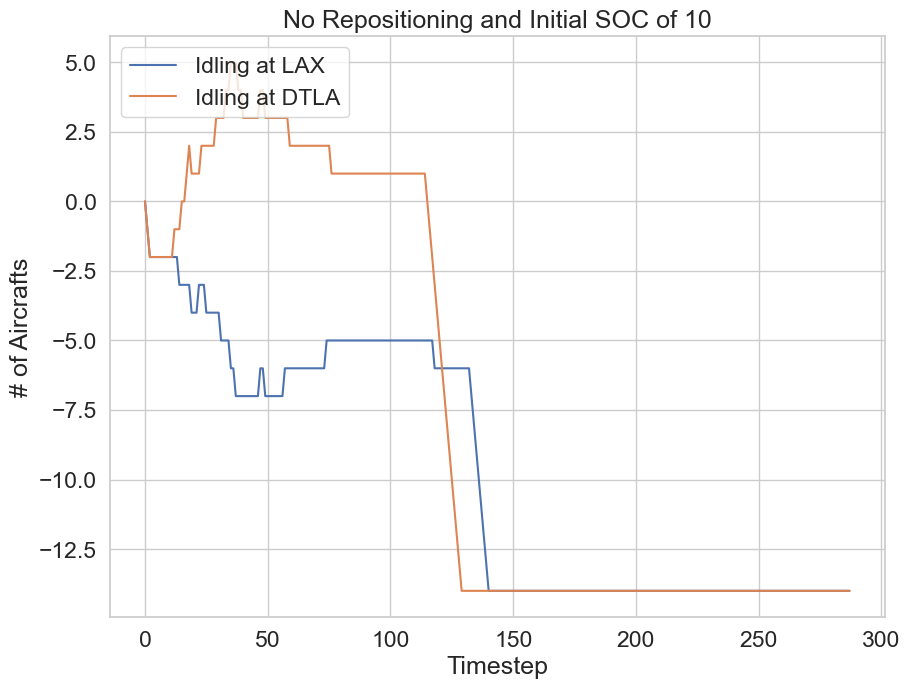

In [95]:
fig, ax = plt.subplots(figsize=(10,7.55))
sns.lineplot(output[:,0]-num_aircraft, label='Idling at LAX', ax=ax)
sns.lineplot(output[:,1]-num_aircraft, label='Idling at DTLA', ax=ax)
# sns.lineplot(output[:,4]-num_aircraft, label='Charging at DTLA', ax=ax)
# sns.lineplot(output[:,5]-num_aircraft, label='Charging at LAX', ax=ax)
plt.legend(loc='upper left') 
ax.set(xlabel='Timestep', ylabel='# of Aircrafts', title='No Repositioning and Initial SOC of 10')

In [471]:
gamma

array([ 5.,  5.,  5.,  5.,  5., 10., 10., 10., 20., 75.])

In [469]:
schedule = pd.read_csv('schedule.csv')
schedule['schedule'] = schedule['schedule'] // 5 * 5
schedule[schedule['od'] == 'LAX_DTLA']

u_lax_dtla = []
u_dtla_lax = []
for i in range(0,1440,5):
    id = schedule[(schedule['od'] == 'LAX_DTLA') & (schedule['schedule'] == i)]
    u_lax_dtla.append(id.shape[0])
    id = schedule[(schedule['od'] == 'DTLA_LAX') & (schedule['schedule'] == i)]
    u_dtla_lax.append(id.shape[0])
u_lax_dtla = np.array(u_lax_dtla)
u_dtla_lax = np.array(u_dtla_lax)

In [511]:
def c(vertiport,initial_soc,target_soc,time):
    if time < 2:
        return 0
    else:
        if (vertiport==1):
            if (initial_soc==0) & (target_soc==1):
                return u_dtla_lax[time-2]
            else:
                return 0
        elif (vertiport==2):
            if (initial_soc==0) & (target_soc==1):
                return u_lax_dtla[time-2]
            else:
                return 0
            
def u(origin, destination, state, time):
    if (state!=1) | (time<0):
        return 0
    else:
        if (origin == 1) & (destination == 2):
            return u_lax_dtla[time]
        elif (origin == 2) & (destination == 1):
            return u_dtla_lax[time]

In [512]:
def n(i,k,t, gamma=2):
    if i == 1:
        j = 2
    elif i == 2:
        j = 1


    if t < 2:
        return 0
    else:
        idle_from_previous_step = n(i,k,t-1)
        print("idle_from_previous_step:", idle_from_previous_step)

        incoming = u(origin=j, destination=i, state=k+1, time=t-2)
        print('incoming:', incoming)

        outgoing = u(origin=i, destination=j, state=k, time=t)
        print("outgoing:", outgoing)

        sum_charged = 0
        for initial_state in range(k-1,10):
            sum_charged += c(vertiport=i, initial_soc=initial_state, target_soc=k, time=t-gamma)
        print('sum_charged:', sum_charged)

        
        sum_to_charge = 0
        for final_state in range(k+1,10):
            sum_to_charge += c(vertiport=i, initial_soc=k, target_soc=final_state, time=t)
        print('sum_to_charge', sum_to_charge)

    return idle_from_previous_step+incoming-outgoing+sum_charged-sum_to_charge

In [513]:
n10 = []
n11 = []
n20 = []
n21 = []
for T in range(288):
    n10.append(n(1,0,T))
    n11.append(n(1,1,T))
    n20.append(n(2,0,T))
    n21.append(n(2,1,T))

idle_from_previous_step: 0
incoming: 1
outgoing: 0
sum_charged: 0
sum_to_charge 1
idle_from_previous_step: 0
incoming: 0
outgoing: 1
sum_charged: 0
sum_to_charge 0
idle_from_previous_step: 0
incoming: 1
outgoing: 0
sum_charged: 0
sum_to_charge 1
idle_from_previous_step: 0
incoming: 0
outgoing: 1
sum_charged: 0
sum_to_charge 0
idle_from_previous_step: 0
incoming: 1
outgoing: 0
sum_charged: 0
sum_to_charge 1
idle_from_previous_step: 0
incoming: 0
outgoing: 0
sum_charged: 0
sum_to_charge 0
idle_from_previous_step: 0
incoming: 0
outgoing: 1
sum_charged: 0
sum_to_charge 0
idle_from_previous_step: -1
incoming: 0
outgoing: 1
sum_charged: 0
sum_to_charge 0
idle_from_previous_step: 0
incoming: 1
outgoing: 0
sum_charged: 0
sum_to_charge 1
idle_from_previous_step: 0
incoming: 1
outgoing: 0
sum_charged: 0
sum_to_charge 1
idle_from_previous_step: 0
incoming: 0
outgoing: 1
sum_charged: 0
sum_to_charge 0
idle_from_previous_step: -1
incoming: 0
outgoing: 0
sum_charged: 0
sum_to_charge 0
idle_from_prev

Text(0.5, 1.0, 'Idle Aircrafts with Charging Policy that Minimizes Charging Time')

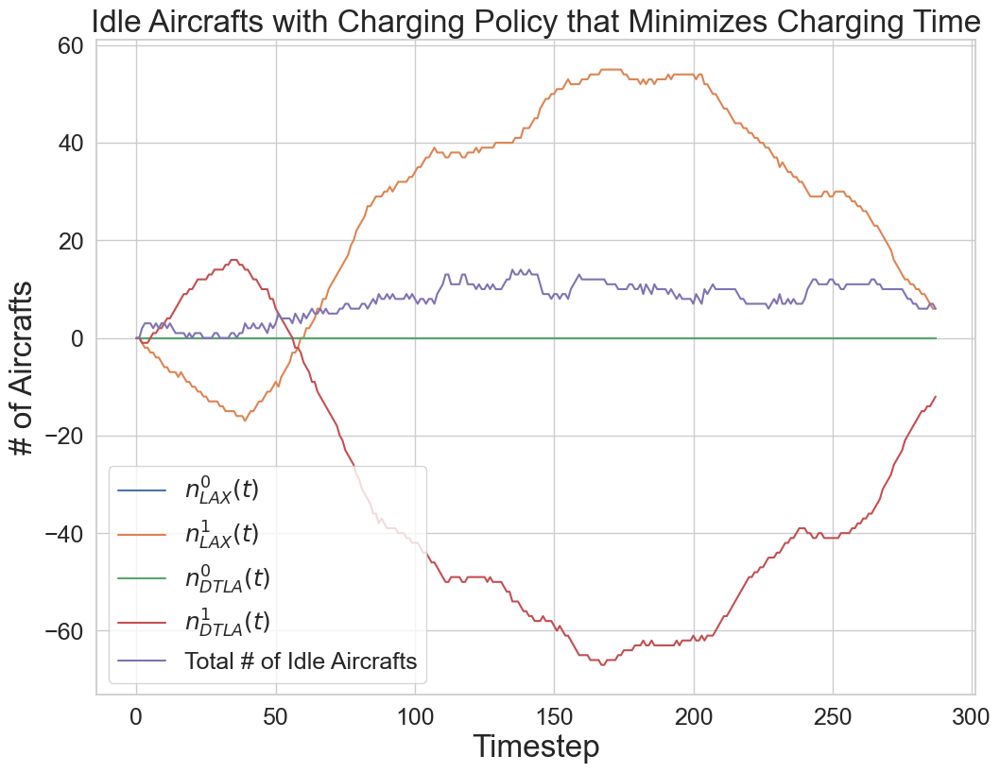

In [525]:
fig, ax = plt.subplots(figsize=(12,9))
plt.plot(n10, label='$n_{LAX}^{0}(t)$')
plt.plot(n11, label='$n_{LAX}^{1}(t)$')
plt.plot(n20, label='$n_{DTLA}^{0}(t)$')
plt.plot(n21, label='$n_{DTLA}^{1}(t)$')
plt.plot(abs(np.array(n21)+np.array(n11)), label='Total # of Idle Aircrafts')
plt.legend()
plt.xlabel('Timestep')
plt.ylabel('# of Aircrafts')
plt.title('Idle Aircrafts with Charging Policy that Minimizes Charging Time')

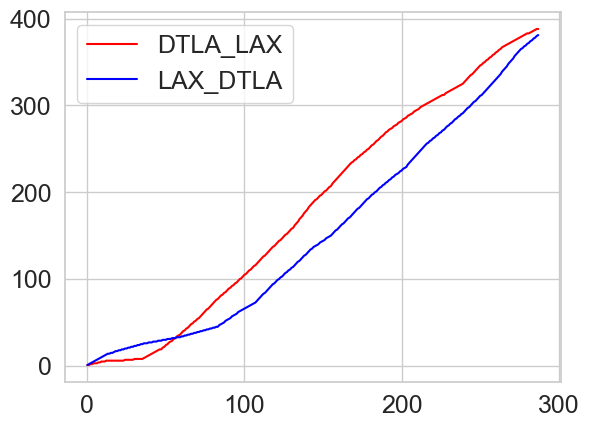

In [510]:
plt.plot(np.cumsum(u_dtla_lax),color='red', label='DTLA_LAX')
plt.plot(np.cumsum(u_lax_dtla),color='blue', label='LAX_DTLA')
plt.legend()

Text(0, 0.5, '# of Aircrafts')

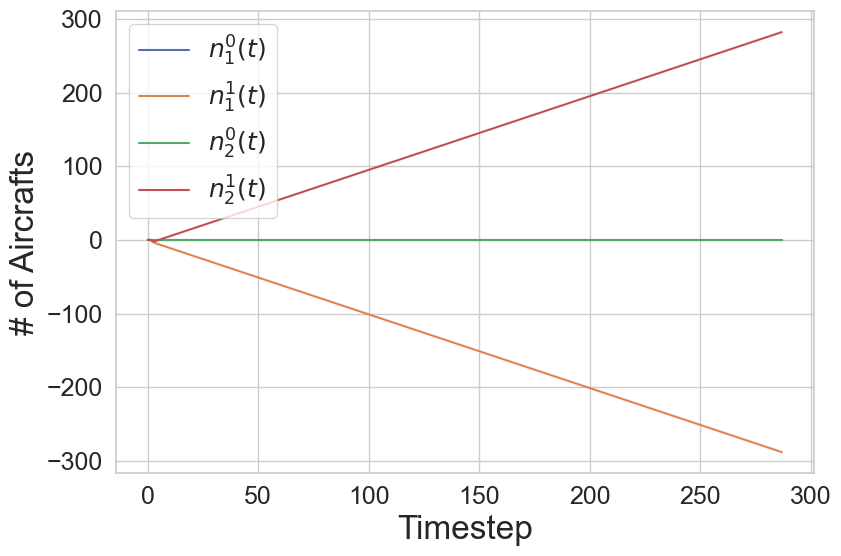